In [2]:
import glob
import numpy as np
import pandas as pd
import os
import shutil 
import matplotlib.pyplot as plt
from keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, array_to_img
from collections import Counter
from sklearn.datasets import make_classification
from sklearn.preprocessing import LabelEncoder 
from tensorflow.keras.applications import ResNet50
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, GlobalAveragePooling2D
from keras import optimizers, losses, utils, Model
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, InputLayer, Activation, BatchNormalization
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
import tensorflow as tf
from tensorflow.python.client import device_lib
import math
import tensorflow
from sklearn.metrics import confusion_matrix
import seaborn as sns
from tensorflow import keras

# Display
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.cm as cm
%matplotlib inline

# Data Loading

In [8]:
# save image dimensions to variables
IMG_WIDTH=224
IMG_HEIGHT=224
IMG_DIM = (IMG_WIDTH, IMG_HEIGHT)

### Load Training Data

In [9]:
# put training data file names to a list
poor_files_train = glob.glob('data\\Brussels statistical sectors cropped\\train\\0-23162\\*') 
avg1_files_train = glob.glob('data\\Brussels statistical sectors cropped\\train\\23162-28595\\*') 
avg2_files_train = glob.glob('data\\Brussels statistical sectors cropped\\train\\28595-36069\\*') 
rich_files_train = glob.glob('data\\Brussels statistical sectors cropped\\train\\36069-Inf\\*') 
 
poor_train = [fn for fn in poor_files_train] 
avg1_train = [fn for fn in avg1_files_train] 
avg2_train = [fn for fn in avg2_files_train] 
rich_train = [fn for fn in rich_files_train] 
train_files = [*poor_train, *avg1_train, *avg2_train, *rich_train]
train_files_length = len(train_files)

# load training images from the files
train_imgs = [img_to_array(load_img(img, target_size=IMG_DIM)) for img in train_files]
train_imgs = np.array(train_imgs)
train_imgs = train_imgs.reshape(train_files_length, IMG_WIDTH, IMG_HEIGHT, 3)

# create a variable with corresponding class labels
train_labels = ['1-poor'] * len(poor_train) + ['2-avg1'] * len(avg1_train) + ['3-avg2'] * len(avg2_train) + ['4-rich'] * len(rich_train)

### Load Validation Data

In [10]:
# put validation data file names to a list
poor_files_validation = glob.glob('data\\Brussels statistical sectors cropped\\valid\\0-23162\\*') 
avg1_files_validation = glob.glob('data\\Brussels statistical sectors cropped\\valid\\23162-28595\\*') 
avg2_files_validation = glob.glob('data\\Brussels statistical sectors cropped\\valid\\28595-36069\\*') 
rich_files_validation = glob.glob('data\\Brussels statistical sectors cropped\\valid\\36069-Inf\\*') 
 
poor_validation = [fn for fn in poor_files_validation] 
avg1_validation = [fn for fn in avg1_files_validation] 
avg2_validation = [fn for fn in avg2_files_validation] 
rich_validation = [fn for fn in rich_files_validation] 
validation_files = [*poor_validation, *avg1_validation, *avg2_validation, *rich_validation]
validation_files_length = len(validation_files)

# load validation images from the files
validation_imgs = [img_to_array(load_img(img, target_size=IMG_DIM)) for img in validation_files]
validation_imgs = np.array(validation_imgs)
validation_imgs = validation_imgs.reshape(validation_files_length, IMG_WIDTH, IMG_HEIGHT, 3)

# create a variable with corresponding class labels
validation_labels = ['1-poor'] * len(poor_validation) + ['2-avg1'] * len(avg1_validation) + ['3-avg2'] * len(avg2_validation) + ['4-rich'] * len(rich_validation)

### Load Testing Data

In [11]:
# put testing data file names to a list
poor_files_test = glob.glob('data\\Brussels statistical sectors cropped\\test\\0-23162\\*') 
avg1_files_test = glob.glob('data\\Brussels statistical sectors cropped\\test\\23162-28595\\*') 
avg2_files_test = glob.glob('data\\Brussels statistical sectors cropped\\test\\28595-36069\\*') 
rich_files_test = glob.glob('data\\Brussels statistical sectors cropped\\test\\36069-Inf\\*') 
 
poor_test = [fn for fn in poor_files_test] 
avg1_test = [fn for fn in avg1_files_test] 
avg2_test = [fn for fn in avg2_files_test] 
rich_test = [fn for fn in rich_files_test] 
test_files = [*poor_test, *avg1_test, *avg2_test, *rich_test]
test_files_length = len(test_files)

# load testing images from the files
test_imgs = [img_to_array(load_img(img, target_size=IMG_DIM)) for img in test_files]
test_imgs = np.array(test_imgs)
test_imgs = test_imgs.reshape(test_files_length, IMG_WIDTH, IMG_HEIGHT, 3)

# create a variable with corresponding class labels
test_labels = ['1-poor'] * len(poor_test) + ['2-avg1'] * len(avg1_test) + ['3-avg2'] * len(avg2_test) + ['4-rich'] * len(rich_test)

In [12]:
print('Train dataset shape:', train_imgs.shape, 
      '\nValidation dataset shape:', validation_imgs.shape,
      '\nTest dataset shape:', test_imgs.shape)

Train dataset shape: (8980, 224, 224, 3) 
Validation dataset shape: (2321, 224, 224, 3) 
Test dataset shape: (2321, 224, 224, 3)


In [13]:
print('Training dataset labels distribution:', Counter(train_labels), 
 '\nValidation dataset labels distribution:', Counter(validation_labels), 
 '\nTesting dataset labels distribution:', Counter(test_labels))

Training dataset labels distribution: Counter({'1-poor': 2245, '2-avg1': 2245, '3-avg2': 2245, '4-rich': 2245}) 
Validation dataset labels distribution: Counter({'4-rich': 736, '3-avg2': 552, '1-poor': 520, '2-avg1': 513}) 
Testing dataset labels distribution: Counter({'4-rich': 783, '3-avg2': 559, '2-avg1': 504, '1-poor': 475})


# Data Processing

### Encode Class Labels

In [14]:
# convert class labels to integers
le = LabelEncoder() 
le.fit(train_labels) 
train_labels_enc = le.transform(train_labels) 
validation_labels_enc = le.transform(validation_labels)

In [15]:
# check if encodings are correct
le.transform(['1-poor', '2-avg1', '3-avg2', '4-rich'])

array([0, 1, 2, 3])

In [16]:
# one hot encoding for training data
one_hot_train = np.zeros((train_labels_enc.size, train_labels_enc.max()+1))
one_hot_train[np.arange(train_labels_enc.size), train_labels_enc] = 1
one_hot_train

array([[1., 0., 0., 0.],
       [1., 0., 0., 0.],
       [1., 0., 0., 0.],
       ...,
       [0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.]])

In [17]:
# one hot encoding for validation data
one_hot_valid = np.zeros((validation_labels_enc.size, validation_labels_enc.max()+1))
one_hot_valid[np.arange(validation_labels_enc.size), validation_labels_enc] = 1
one_hot_valid

array([[1., 0., 0., 0.],
       [1., 0., 0., 0.],
       [1., 0., 0., 0.],
       ...,
       [0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.]])

### Data Augmentation

In [18]:
train_datagen = ImageDataGenerator(rescale=1./255, 
                                   rotation_range=40, 
                                   zoom_range = 0.2, 
                                   horizontal_flip = True, 
                                   vertical_flip=True, 
                                   brightness_range=[0.7,1.3])
val_datagen = ImageDataGenerator(rescale=1./255)

# Model Training

In [19]:
# create the base ResNet model
baseModel = ResNet50(include_top=False, 
                     weights='imagenet', 
                     pooling='avg', 
                     input_shape=(224, 224, 3))
headModel = baseModel.output

# comment/uncomment lines below to add additional layers to the base model and create a custom ResNet

headModel = Dense(256)(headModel)
headModel = BatchNormalization()(headModel)
headModel = Activation("relu")(headModel)

headModel = Dense(64)(headModel)
headModel = BatchNormalization()(headModel)
headModel = Activation("relu")(headModel)

headModel = Dropout(0.2)(headModel)
#headModel = Dropout(0.5)(headModel)

headModel = Dense(4, activation="softmax")(headModel)

model = Model(inputs=baseModel.input, outputs=headModel)
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [20]:
# select other model hyperparameters (optimizer, loss function, learning rate and metric for validation)
adam = optimizers.Adam(lr=0.000001)
model.compile(optimizer=adam, 
              loss=losses.categorical_crossentropy, 
              metrics=['AUC'])

In [21]:
# prepare batches of training and validation images
BATCH_SIZE = 64
train_generator = train_datagen.flow(train_imgs, 
                                     one_hot_train, 
                                     batch_size=BATCH_SIZE, 
                                     seed=13)
val_generator = val_datagen.flow(validation_imgs, 
                                 one_hot_valid, 
                                 batch_size=BATCH_SIZE, 
                                 seed=13)

In [22]:
# use model checkpoints to save models and early stopping
MODEL_NAME = "Model1000"
check_point = ModelCheckpoint(filepath="data/Brussels statistical sectors cropped/Modeliai/ResNet50/" + MODEL_NAME + ".h5", 
                              verbose = 1, 
                              save_best_only = True)
early_stopping = EarlyStopping(monitor='val_loss', 
                               patience=15)

In [23]:
# check if GPU is available for training
def get_available_devices():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos]

print(get_available_devices()) 
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

['/device:CPU:0', '/device:GPU:0']
Num GPUs Available:  1


In [18]:
# train the model
with tf.device('/device:GPU:0'):
    history = model.fit_generator(train_generator, 
                                  steps_per_epoch=math.ceil(train_files_length/BATCH_SIZE),
                                  epochs = 1000,
                                  initial_epoch=0,
                                  validation_data=val_generator, 
                                  validation_steps=math.ceil(validation_files_length/BATCH_SIZE), 
                                  verbose=1,
                                  callbacks=[check_point, early_stopping]
                                 )

C:\Users\aistm\anaconda3\lib\site-packages\tensorflow\python\keras\engine\training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/1000
141/141 [==============================] - 103s 641ms/step - loss: 1.6384 - auc: 0.5154 - val_loss: 2.2168 - val_auc: 0.4737

Epoch 00001: val_loss improved from inf to 2.21685, saving model to data/Brussels statistical sectors cropped/Modeliai/ResNet50\Model1000.h5
Epoch 2/1000
141/141 [==============================] - 95s 668ms/step - loss: 1.5870 - auc: 0.5391 - val_loss: 1.7025 - val_auc: 0.5061

Epoch 00002: val_loss improved from 2.21685 to 1.70253, saving model to data/Brussels statistical sectors cropped/Modeliai/ResNet50\Model1000.h5
Epoch 3/1000
141/141 [==============================] - 102s 719ms/step - loss: 1.5700 - auc: 0.5488 - val_loss: 1.5197 - val_auc: 0.5725

Epoch 00003: val_loss improved from 1.70253 to 1.51970, saving model to data/Brussels statistical sectors cropped/Modeliai/ResNet50\Model1000.h5
Epoch 4/1000
141/141 [==============================] - 118s 831ms/step - loss: 1.5254 - auc: 0.5697 - val_loss: 1.6121 - val_auc: 0.5650

Epoch 00004: v

KeyboardInterrupt: 

In [23]:
history

import glob
import numpy as np
import pandas as pd
import os
import shutil 
import matplotlib.pyplot as plt
from keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, array_to_img
from collections import Counter
from sklearn.datasets import make_classification
from sklearn.preprocessing import LabelEncoder 
from tensorflow.keras.applications import ResNet50
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, GlobalAveragePooling2D
from keras import optimizers, losses, utils, Model
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, InputLayer, Activation, BatchNormalization
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
import tensorflow as tf
from tensorflow.python.client import device_lib
%matplotlib inline
# save image dimensions to variables
IMG_WIDTH=224
IMG_HEIGHT=224
IMG_DIM = (IMG_WIDTH, IMG_HEIGHT)
# put training data file names to a list
poor_

# Model Evaluation

### Plots

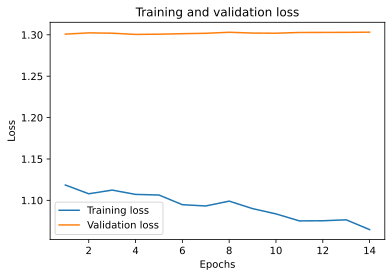

In [24]:
# plot model's loss
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
def plot_metric(history, metric):
    train_metrics = history.history[metric]
    val_metrics = history.history['val_'+metric]
    epochs = range(1, len(train_metrics) + 1)
    plt.plot(epochs, train_metrics)
    plt.plot(epochs, val_metrics)
    plt.title('Training and validation '+ metric)
    plt.xlabel("Epochs")
    #plt.ylim(1, 2)
    plt.ylabel("Loss")
    plt.legend(["Training loss", "Validation loss"])
    plt.show()
plot_metric(history, 'loss')

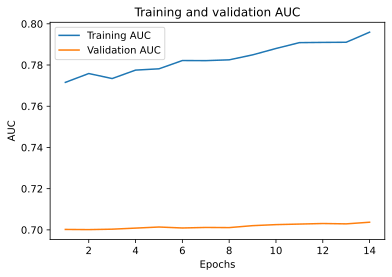

In [25]:
# plot model's AUC
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
def plot_metric(history, metric):
    train_metrics = history.history[metric]
    val_metrics = history.history['val_'+metric]
    epochs = range(1, len(train_metrics) + 1)
    plt.plot(epochs, train_metrics)
    plt.plot(epochs, val_metrics)
    plt.title('Training and validation AUC')
    plt.xlabel("Epochs")
    #plt.ylim(1, 1.5)
    plt.ylabel("AUC")
    plt.legend(["Training AUC", "Validation AUC"])
    plt.show()
plot_metric(history, 'auc')

### Confusion Matrices

In [24]:
# load model that you want to evaluate
model = tensorflow.keras.models.load_model('data/Brussels statistical sectors cropped/Modeliai/ResNet50/Model231.h5')

In [25]:
# prepare training images for predicting by converting them to float and normalising them 
train_imgs_scaled = train_imgs.astype('float32') 
train_imgs_scaled /= 255.

# same with validation images
validation_imgs_scaled = validation_imgs.astype('float32') 
validation_imgs_scaled /= 255. 

# same with testing images
test_imgs_scaled = test_imgs.astype('float32') 
test_imgs_scaled /= 255.

#### Training Dataset

In [26]:
# predict class for training dataset and for each image select class with highest probability
pred_train_scaled = model.predict(train_imgs_scaled)
max_index_train_scaled = pred_train_scaled.argmax(axis=1)

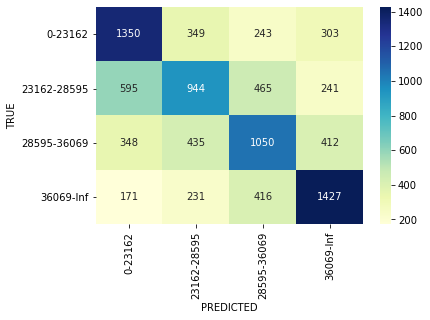

In [27]:
# generate non-normalised confusion matrix for training dataset and plot it
conf_matrix_train = confusion_matrix(train_labels_enc, 
                                     max_index_train_scaled)

ax = plt.axes()
sns.heatmap(conf_matrix_train, 
            annot=True,
            fmt="d", 
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

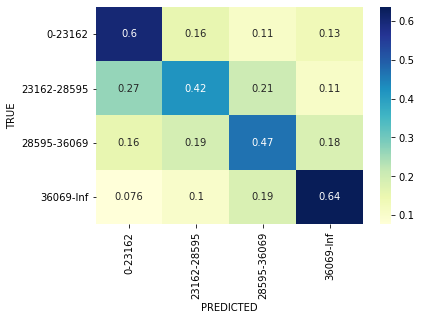

In [28]:
# generate normalised confusion matrix for training dataset and plot it
conf_matrix_train_norm = confusion_matrix(train_labels_enc, 
                                          max_index_train_scaled, 
                                          normalize = 'true')

ax = plt.axes()
sns.heatmap(conf_matrix_train_norm, 
            annot=True,
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

#### Validation Dataset

In [29]:
# predict class for validation dataset and for each image select class with highest probability
pred_valid_scaled = model.predict(validation_imgs_scaled)
max_index_valid_scaled = pred_valid_scaled.argmax(axis=1)

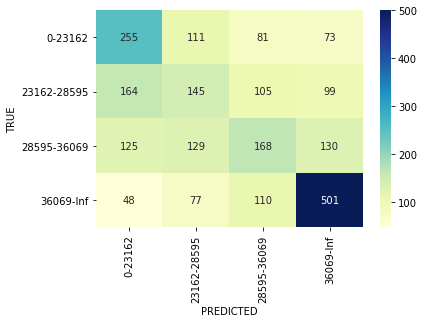

In [30]:
# generate non-normalised confusion matrix for validation dataset and plot it
conf_matrix_valid = confusion_matrix(validation_labels_enc, 
                                     max_index_valid_scaled)

ax = plt.axes()
sns.heatmap(conf_matrix_valid, 
            annot=True, 
            fmt="d", 
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

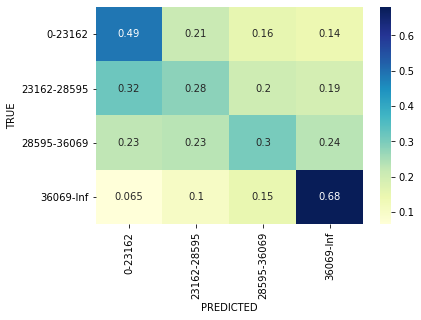

In [31]:
# generate normalised confusion matrix for validation dataset and plot it
conf_matrix_valid_norm = confusion_matrix(validation_labels_enc, 
                                          max_index_valid_scaled, 
                                          normalize = 'true')

ax = plt.axes()
sns.heatmap(conf_matrix_valid_norm, 
            annot=True, 
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

#### Testing Dataset

In [32]:
# predict class for testing dataset and for each image select class with highest probability
pred_test_scaled = model.predict(test_imgs_scaled)
max_index_test_scaled = pred_test_scaled.argmax(axis=1)

# encode class labels for testing dataset
test_labels_enc = le.transform(test_labels) 

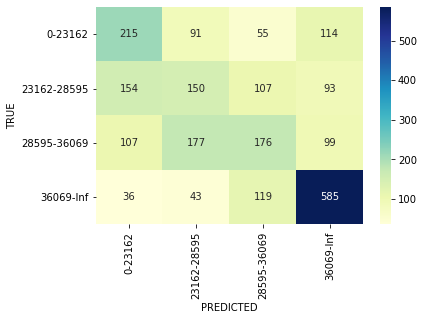

In [33]:
# generate non-normalised confusion matrix for testing dataset and plot it
conf_matrix_test = confusion_matrix(test_labels_enc, 
                                    max_index_test_scaled)

ax = plt.axes()
sns.heatmap(conf_matrix_test, 
            annot=True, 
            fmt="d", 
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

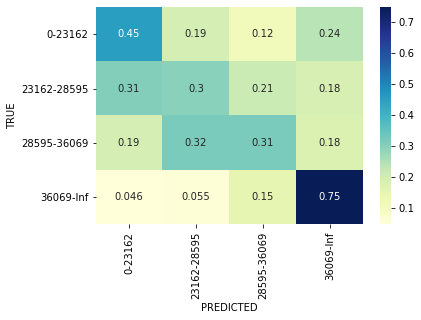

In [34]:
# generate normalised confusion matrix for testing dataset and plot it
conf_matrix_test_norm = confusion_matrix(test_labels_enc, 
                                         max_index_test_scaled, 
                                         normalize = 'true')

ax = plt.axes()
sns.heatmap(conf_matrix_test_norm, 
            annot=True, 
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

#### Testing Dataset - Sector Level

In [35]:
# get sector names for images in the testing dataset and their corresponding predicted and true class
test_sectors = []
for img_path in test_files:
    test_sector = ' - '.join(img_path.split("\\")[-1][:-4].split(" - ")[:-1])
    test_sectors.append(test_sector)
    
sectors_pred_df = {"sectors": test_sectors, "predicted_class": max_index_test_scaled, "true_class": test_labels_enc}
sectors_pred_df = pd.DataFrame(sectors_pred_df)
sectors_pred_df

,sectors,predicted_class,true_class
0,AGRAFE-NORBERT GILLE,1,0
1,AGRAFE-NORBERT GILLE,3,0
2,AGRAFE-NORBERT GILLE,0,0
3,AGRAFE-NORBERT GILLE,0,0
4,AGRAFE-NORBERT GILLE,0,0
...,...,...,...
2316,VRONERODE,3,3
2317,VRONERODE,3,3
2318,VRONERODE,3,3
2319,VRONERODE,3,3


In [36]:
# get predicted class for each sector in the test dataset using majority voting
sectors_pred = sectors_pred_df.groupby(['sectors','true_class']).agg(lambda x:x.value_counts().index[0])
sectors_pred.reset_index(inplace=True)
sectors_pred

,sectors,true_class,predicted_class
0,ABELOOS,2,2
1,AGRAFE-NORBERT GILLE,0,0
2,ALBERT-WIJK,1,0
3,ALSEMBERG-NOORD,1,1
4,ARBORETUM,1,3
...,...,...,...
119,WERYSTRAAT,1,0
120,ZAVELENBERGGAARDE,1,3
121,ZEVENBUNDER,1,2
122,ZEVENSTERREN,2,1


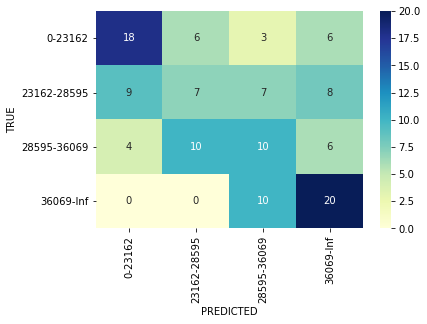

In [37]:
# generate non-normalised confusion matrix for the sectors in testing dataset and plot it
conf_matrix_test_sectors = confusion_matrix(sectors_pred['true_class'], 
                                            sectors_pred['predicted_class'])

ax = plt.axes()
sns.heatmap(conf_matrix_test_sectors, 
            annot=True, 
            fmt="d", 
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

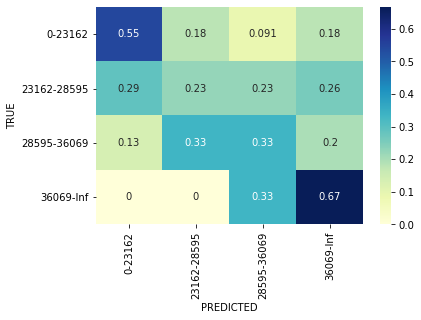

In [38]:
# generate normalised confusion matrix for the sectors in testing dataset and plot it
conf_matrix_test_norm_sectors = confusion_matrix(sectors_pred['true_class'], 
                                                 sectors_pred['predicted_class'], 
                                                 normalize = 'true')

ax = plt.axes()
sns.heatmap(conf_matrix_test_norm_sectors, 
            annot=True, 
            cmap="YlGnBu", 
            xticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            yticklabels=["0-23162", "23162-28595", "28595-36069", "36069-Inf"], 
            ax = ax)
ax.set_xlabel('PREDICTED')
ax.set_ylabel('TRUE')
plt.show()

# Interpreting the Model Using Grad-CAM

In [39]:
# load the best model to interpret and remove softmax from the last layer
model = tensorflow.keras.models.load_model('data/Brussels statistical sectors cropped/Modeliai/ResNet50/Model231.h5')
model.layers[-1].activation = None
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [34]:
# names of convolutional layers we want to interpret
conv_layer_names = ['conv2_block1_out', 'conv2_block2_out', 'conv2_block3_out', 'conv3_block1_out', 
                    'conv3_block2_out', 'conv3_block3_out', 'conv3_block4_out', 'conv4_block1_out', 
                    'conv4_block2_out', 'conv4_block3_out', 'conv4_block4_out', 'conv4_block5_out',  
                    'conv4_block6_out', 'conv5_block1_out', 'conv5_block2_out', 'conv5_block3_out']

In [40]:
conv_layer_names = ['conv5_block3_out']

In [41]:
# these functions are taken and adapted from https://keras.io/examples/vision/grad_cam/

def get_img_array(img_path, size):
    img = keras.preprocessing.image.load_img(img_path, target_size=size)
    array = keras.preprocessing.image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array


def make_gradcam_heatmap(img_array, model, conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the given conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the conv layer
    with tf.GradientTape() as tape:
        conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the conv layer
    grads = tape.gradient(class_channel, conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    conv_layer_output = conv_layer_output[0]
    heatmap = conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def save_and_display_gradcam(img_path, heatmap, cam_path, alpha=0.6):
    # Load the original image
    img = keras.preprocessing.image.load_img(img_path)
    img = keras.preprocessing.image.img_to_array(img)

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)

    # Save the superimposed image
    superimposed_img.save(cam_path)

    # Display Grad CAM
    display(Image(cam_path))

In [42]:
# get training files with their corresponding true class, predicted class and prediction probability 
train_pred = {"file_names": train_files, "pred_prob": pred_train_scaled.max(axis=1), "pred_class": max_index_train_scaled, "true_class": train_labels_enc}
train_pred_df = pd.DataFrame(train_pred)
train_pred_df

,file_names,pred_prob,pred_class,true_class
0,data\Brussels statistical sectors cropped\trai...,0.390751,2,0
1,data\Brussels statistical sectors cropped\trai...,0.390751,2,0
2,data\Brussels statistical sectors cropped\trai...,0.349788,0,0
3,data\Brussels statistical sectors cropped\trai...,0.349788,0,0
4,data\Brussels statistical sectors cropped\trai...,0.636594,0,0
...,...,...,...,...
8975,data\Brussels statistical sectors cropped\trai...,0.334108,2,3
8976,data\Brussels statistical sectors cropped\trai...,0.315479,0,3
8977,data\Brussels statistical sectors cropped\trai...,0.560583,3,3
8978,data\Brussels statistical sectors cropped\trai...,0.835682,3,3


In [43]:
# get validation files with their corresponding true class, predicted class and prediction probability 
valid_pred = {"file_names": validation_files, "pred_prob": pred_valid_scaled.max(axis=1), "pred_class": max_index_valid_scaled, "true_class": validation_labels_enc}
valid_pred_df = pd.DataFrame(valid_pred)
valid_pred_df

,file_names,pred_prob,pred_class,true_class
0,data\Brussels statistical sectors cropped\vali...,0.482880,1,0
1,data\Brussels statistical sectors cropped\vali...,0.486418,0,0
2,data\Brussels statistical sectors cropped\vali...,0.447444,2,0
3,data\Brussels statistical sectors cropped\vali...,0.376854,2,0
4,data\Brussels statistical sectors cropped\vali...,0.496307,1,0
...,...,...,...,...
2316,data\Brussels statistical sectors cropped\vali...,0.526044,3,3
2317,data\Brussels statistical sectors cropped\vali...,0.826747,3,3
2318,data\Brussels statistical sectors cropped\vali...,0.912273,3,3
2319,data\Brussels statistical sectors cropped\vali...,0.347236,2,3


In [44]:
# get testing files with their corresponding true class, predicted class and prediction probability 
test_pred = {"file_names": test_files, "pred_prob": pred_test_scaled.max(axis=1), "pred_class": max_index_test_scaled, "true_class": test_labels_enc}
test_pred_df = pd.DataFrame(test_pred)
test_pred_df

,file_names,pred_prob,pred_class,true_class
0,data\Brussels statistical sectors cropped\test...,0.418841,1,0
1,data\Brussels statistical sectors cropped\test...,0.327374,3,0
2,data\Brussels statistical sectors cropped\test...,0.753777,0,0
3,data\Brussels statistical sectors cropped\test...,0.849160,0,0
4,data\Brussels statistical sectors cropped\test...,0.691715,0,0
...,...,...,...,...
2316,data\Brussels statistical sectors cropped\test...,0.835115,3,3
2317,data\Brussels statistical sectors cropped\test...,0.761184,3,3
2318,data\Brussels statistical sectors cropped\test...,0.811517,3,3
2319,data\Brussels statistical sectors cropped\test...,0.901587,3,3


In [45]:
# concatenate the datasets
full_pred_df = pd.concat([train_pred_df, valid_pred_df, test_pred_df])
full_pred_df

,file_names,pred_prob,pred_class,true_class
0,data\Brussels statistical sectors cropped\trai...,0.390751,2,0
1,data\Brussels statistical sectors cropped\trai...,0.390751,2,0
2,data\Brussels statistical sectors cropped\trai...,0.349788,0,0
3,data\Brussels statistical sectors cropped\trai...,0.349788,0,0
4,data\Brussels statistical sectors cropped\trai...,0.636594,0,0
...,...,...,...,...
2316,data\Brussels statistical sectors cropped\test...,0.835115,3,3
2317,data\Brussels statistical sectors cropped\test...,0.761184,3,3
2318,data\Brussels statistical sectors cropped\test...,0.811517,3,3
2319,data\Brussels statistical sectors cropped\test...,0.901587,3,3


In [49]:
# filter files which have high prediction probability
files_high_prob = full_pred_df.loc[((full_pred_df['pred_prob'] >= 0.8) & (full_pred_df['pred_class'] == 2))]["file_names"]
files_high_prob

877     data\Brussels statistical sectors cropped\trai...
878     data\Brussels statistical sectors cropped\trai...
1001    data\Brussels statistical sectors cropped\trai...
3024    data\Brussels statistical sectors cropped\trai...
3025    data\Brussels statistical sectors cropped\trai...
                              ...                        
1527    data\Brussels statistical sectors cropped\vali...
1528    data\Brussels statistical sectors cropped\vali...
1530    data\Brussels statistical sectors cropped\vali...
1241    data\Brussels statistical sectors cropped\test...
1254    data\Brussels statistical sectors cropped\test...
Name: file_names, Length: 116, dtype: object

In [80]:
# filter files which have high prediction probability
files_high_prob = full_pred_df.loc[((full_pred_df['pred_prob'] >= 0.9) & (full_pred_df['pred_class'] == 0)) | ((full_pred_df['pred_prob'] >= 0.7) & (full_pred_df['pred_class'] == 1)) | ((full_pred_df['pred_prob'] >= 0.895) & (full_pred_df['pred_class'] == 2)) | ((full_pred_df['pred_prob'] >= 0.97) & (full_pred_df['pred_class'] == 3))]["file_names"]
files_high_prob

20      data\Brussels statistical sectors cropped\trai...
21      data\Brussels statistical sectors cropped\trai...
38      data\Brussels statistical sectors cropped\trai...
39      data\Brussels statistical sectors cropped\trai...
40      data\Brussels statistical sectors cropped\trai...
                              ...                        
2292    data\Brussels statistical sectors cropped\test...
2294    data\Brussels statistical sectors cropped\test...
2296    data\Brussels statistical sectors cropped\test...
2298    data\Brussels statistical sectors cropped\test...
2309    data\Brussels statistical sectors cropped\test...
Name: file_names, Length: 301, dtype: object

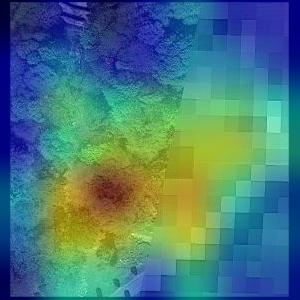

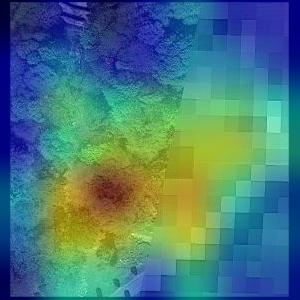

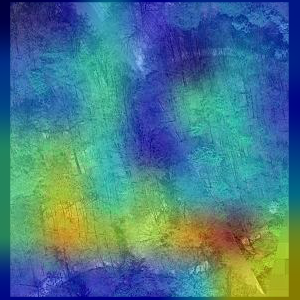

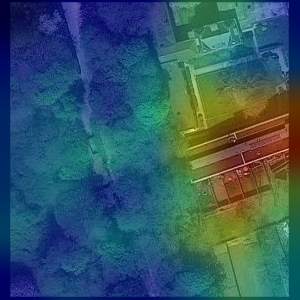

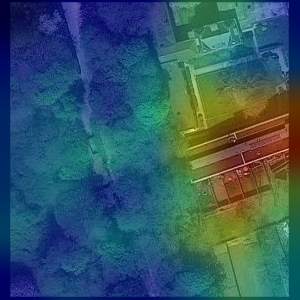

...

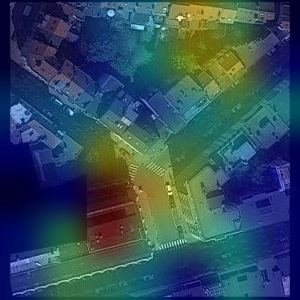

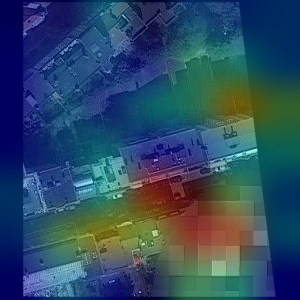

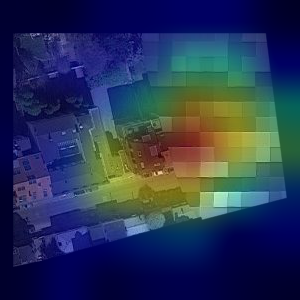

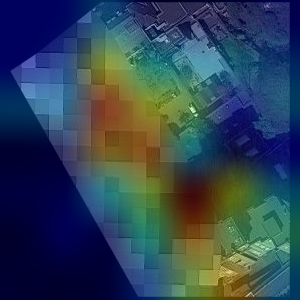

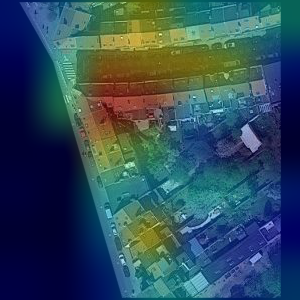

In [50]:
# for each given image and given convolutional layer generate Grad-CAM heatmap and save it
for conv_layer_name in conv_layer_names:
    for img_path in files_high_prob:
        # get image
        img_array = get_img_array(img_path, size=IMG_DIM)
        img_array /= 255.
        
        # get its true and predicted class label and probability of prediction
        true_class = full_pred_df[full_pred_df['file_names'] == img_path]["true_class"].reset_index(drop=True)[0]
        pred_class = full_pred_df[full_pred_df['file_names'] == img_path]["pred_class"].reset_index(drop=True)[0]
        pred_prob = full_pred_df[full_pred_df['file_names'] == img_path]["pred_prob"].reset_index(drop=True)[0]
        
        # apply Grad-CAM and save generated heatmap
        cam_path = "data/top pred heatmaps/" + img_path.split("\\")[-1][:-4] + " -- TRUE LBL " + str(true_class) + " -- PRED LBL " + str(pred_class) + " -- PROB " + str(pred_prob) + " " + conv_layer_name + ".png"
        heatmap = make_gradcam_heatmap(img_array, model, conv_layer_name)
        save_and_display_gradcam(img_path, heatmap, cam_path = cam_path)

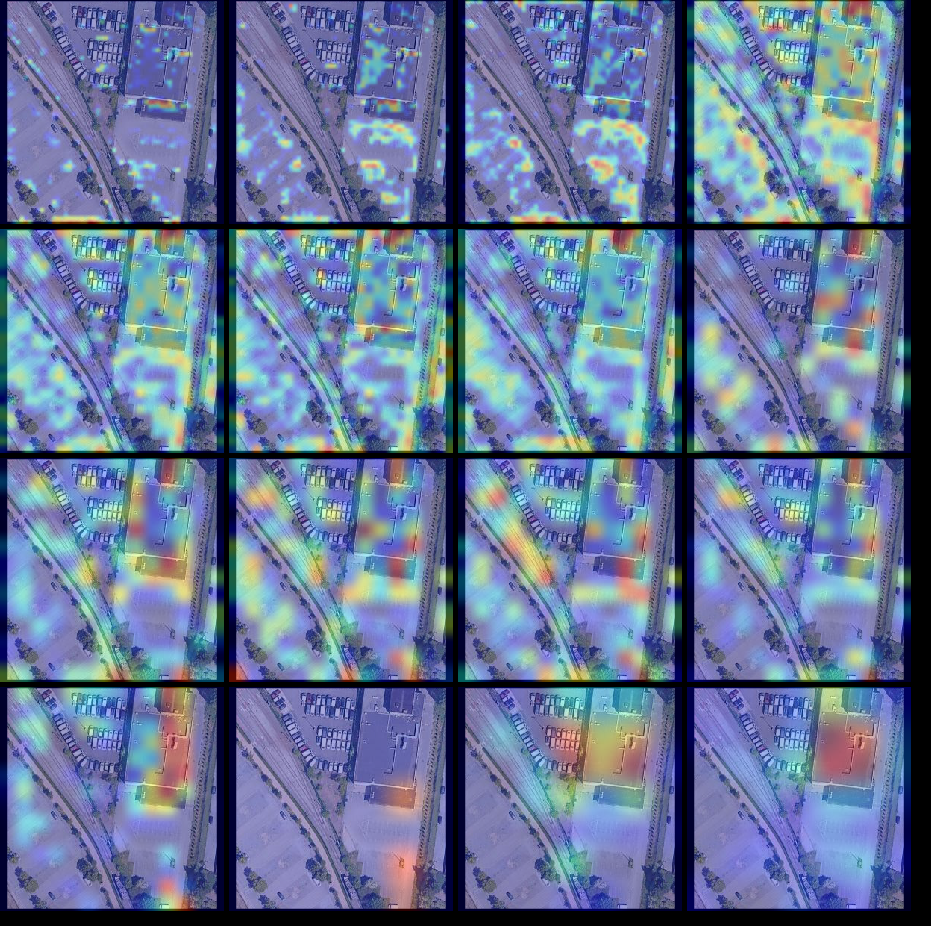

In [97]:
# get names of saved heatmap files
heatmapped_imgs = glob.glob('data\\top pred heatmaps\\*') 
heatmapped_imgs_total = int(len(heatmapped_imgs)/16)

# set margin between images, their dimensions and number of images in a row for a grid of images
margin = 5
n = 4
width = 4 * IMG_WIDTH + 6 * margin
height = 4 * IMG_HEIGHT + 7 * margin
stitched_filters = np.zeros((width, height, 3))

# create a grid a heatmaps for the same image and different convolutional layers
for i in range(heatmapped_imgs_total):
    img_name = heatmapped_imgs[i * 16].split("\\")[-1][:-4]
    for j in range(16):
        # get image
        img = img_to_array(load_img(heatmapped_imgs[i * 16 + j], target_size=(224, 224)))
        
        # hard code positions on the grid
        ii = [0,0,0,0,1,1,1,1,2,2,2,2,3,3,3,3,4,4,4,4,5,5,5,5,6,6,6,6]
        jj = [0,1,2,3,0,1,2,3,0,1,2,3,0,1,2,3,0,1,2,3,0,1,2,3,0,1,2,3]
        stitched_filters[
            (IMG_WIDTH + margin) * ii[j] : (IMG_WIDTH + margin) * ii[j] + IMG_WIDTH,
            (IMG_HEIGHT + margin) * jj[j] : (IMG_HEIGHT + margin) * jj[j] + IMG_HEIGHT,
            :,
        ] = img
    # save image
    keras.preprocessing.image.save_img("data/top heatmaps grid/"+img_name+".png", stitched_filters)


# display one of the images
display(Image("data/top heatmaps grid/"+img_name+".png"))
